In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV

import os

# hide warnings
import warnings
warnings.filterwarnings('ignore')


In [2]:
#Reading the dataset

In [241]:
Housing = pd.read_csv("train.csv")

In [3]:
print(Housing.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
Id               1460 non-null int64
MSSubClass       1460 non-null int64
MSZoning         1460 non-null object
LotFrontage      1201 non-null float64
LotArea          1460 non-null int64
Street           1460 non-null object
Alley            91 non-null object
LotShape         1460 non-null object
LandContour      1460 non-null object
Utilities        1460 non-null object
LotConfig        1460 non-null object
LandSlope        1460 non-null object
Neighborhood     1460 non-null object
Condition1       1460 non-null object
Condition2       1460 non-null object
BldgType         1460 non-null object
HouseStyle       1460 non-null object
OverallQual      1460 non-null int64
OverallCond      1460 non-null int64
YearBuilt        1460 non-null int64
YearRemodAdd     1460 non-null int64
RoofStyle        1460 non-null object
RoofMatl         1460 non-null object
Exterior1st      1460 non-n

In [4]:
Housing.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [5]:
#Checking for column-wise null count in percentage
round(Housing.isnull().sum()/len(Housing.index), 2)*100

Id                 0.0
MSSubClass         0.0
MSZoning           0.0
LotFrontage       18.0
LotArea            0.0
Street             0.0
Alley             94.0
LotShape           0.0
LandContour        0.0
Utilities          0.0
LotConfig          0.0
LandSlope          0.0
Neighborhood       0.0
Condition1         0.0
Condition2         0.0
BldgType           0.0
HouseStyle         0.0
OverallQual        0.0
OverallCond        0.0
YearBuilt          0.0
YearRemodAdd       0.0
RoofStyle          0.0
RoofMatl           0.0
Exterior1st        0.0
Exterior2nd        0.0
MasVnrType         1.0
MasVnrArea         1.0
ExterQual          0.0
ExterCond          0.0
Foundation         0.0
                 ...  
BedroomAbvGr       0.0
KitchenAbvGr       0.0
KitchenQual        0.0
TotRmsAbvGrd       0.0
Functional         0.0
Fireplaces         0.0
FireplaceQu       47.0
GarageType         6.0
GarageYrBlt        6.0
GarageFinish       6.0
GarageCars         0.0
GarageArea         0.0
GarageQual 

In [3]:
all_data_na = (Housing.isnull().sum() / len(Housing)) * 100
all_data_na = all_data_na.drop(all_data_na[all_data_na == 0].index).sort_values(ascending=False)[:30]
missing_data = pd.DataFrame({'Missing Ratio' :all_data_na})
missing_data.head(20)

,Missing Ratio
PoolQC,99.520548
MiscFeature,96.301370
Alley,93.767123
Fence,80.753425
FireplaceQu,47.260274
LotFrontage,17.739726
GarageYrBlt,5.547945
GarageType,5.547945
GarageFinish,5.547945
GarageQual,5.547945


In [6]:
#Missing value treatment

In [242]:
Housing["PoolQC"] = Housing["PoolQC"].fillna("None")

In [244]:
Housing["MiscFeature"] = Housing["MiscFeature"].fillna("None")
Housing["Alley"] = Housing["Alley"].fillna("None")
Housing["Fence"] = Housing["Fence"].fillna("None")
Housing["FireplaceQu"] = Housing["FireplaceQu"].fillna("None")

In [245]:
Housing["LotFrontage"] = Housing.groupby("Neighborhood")["LotFrontage"].transform(lambda x: x.fillna(x.median()))

In [246]:
for col in ('GarageType', 'GarageFinish', 'GarageQual', 'GarageCond'):
    Housing[col] = Housing[col].fillna('None')
    
for col in ('GarageYrBlt', 'GarageArea', 'GarageCars'):
    Housing[col] = Housing[col].fillna(0)

for col in ('BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF','TotalBsmtSF', 'BsmtFullBath', 'BsmtHalfBath'):
    Housing[col] = Housing[col].fillna(0)
    
for col in ('BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2'):
    Housing[col] = Housing[col].fillna('None')

In [247]:
Housing["MasVnrType"] = Housing["MasVnrType"].fillna("None")


In [248]:

Housing['MSZoning'] = Housing['MSZoning'].fillna(Housing['MSZoning'].mode()[0])



In [45]:
#Dropping the utilities column

In [249]:
Housing = Housing.drop(['Utilities'], axis=1)


In [250]:
Housing['Electrical'] = Housing['Electrical'].fillna(Housing['Electrical'].mode()[0])
Housing['KitchenQual'] = Housing['KitchenQual'].fillna(Housing['KitchenQual'].mode()[0])
Housing['Exterior1st'] = Housing['Exterior1st'].fillna(Housing['Exterior1st'].mode()[0])
Housing['Exterior2nd'] = Housing['Exterior2nd'].fillna(Housing['Exterior2nd'].mode()[0])
Housing['SaleType'] = Housing['SaleType'].fillna(Housing['SaleType'].mode()[0])
Housing['MSSubClass'] = Housing['MSSubClass'].fillna("None")

In [253]:
Housing['MasVnrArea'] = Housing['MasVnrArea'].fillna("None")

In [254]:
all_data_na = (Housing.isnull().sum() / len(Housing)) * 100
all_data_na = all_data_na.drop(all_data_na[all_data_na == 0].index).sort_values(ascending=False)[:30]
missing_data = pd.DataFrame({'Missing Ratio' :all_data_na})
missing_data.head(20)

,Missing Ratio


In [252]:
all_data_na = (Housing.isnull().sum() / len(Housing)) * 100
all_data_na = all_data_na.drop(all_data_na[all_data_na == 0].index).sort_values(ascending=False)[:30]
missing_data = pd.DataFrame({'Missing Ratio' :all_data_na})
missing_data.head(20)

,Missing Ratio
MasVnrArea,0.547945


In [49]:
Housing.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,None,Reg,Lvl,Inside,Gtl,...,0,None,None,None,0,2,2008,WD,Normal,12.247699
1,20,RL,80.0,9600,Pave,None,Reg,Lvl,FR2,Gtl,...,0,None,None,None,0,5,2007,WD,Normal,12.109016
2,60,RL,68.0,11250,Pave,None,IR1,Lvl,Inside,Gtl,...,0,None,None,None,0,9,2008,WD,Normal,12.317171
3,70,RL,60.0,9550,Pave,None,IR1,Lvl,Corner,Gtl,...,0,None,None,None,0,2,2006,WD,Abnorml,11.849405
4,60,RL,84.0,14260,Pave,None,IR1,Lvl,FR2,Gtl,...,0,None,None,None,0,12,2008,WD,Normal,12.429220


In [13]:
#Finding out the number of categorical and numerical feature

In [12]:
num = np.array(Housing.dtypes!="object")
print("numeric type",sum(num) )
cat = np.array(Housing.dtypes=="object")
print("object type", sum(cat))

numeric type 38
object type 43


In [14]:
#dropping the column id

In [255]:
#Save the ID column
Housing_ID = Housing['Id']


In [256]:
Housing.drop("Id", axis = 1, inplace = True)


In [18]:
#Understanding the distribution of the target variable

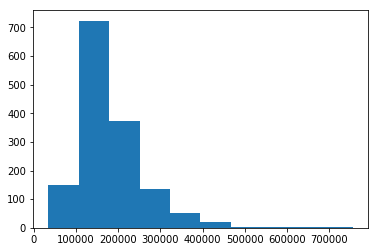

In [257]:
plt.hist(Housing['SalePrice'])
plt.show()

In [37]:
#Since the sale price is skewed we will need to log transform the data

In [38]:
Housing.SalePrice = np.log1p(Housing.SalePrice )
y = Housing.SalePrice

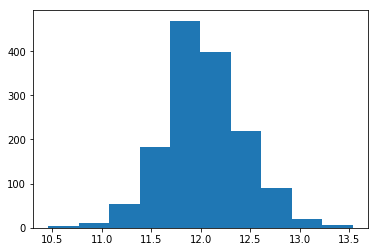

In [40]:
plt.hist(y)
plt.show()

In [41]:
#Hence the target variable is normally distributed

In [20]:
#Considering the above histogram we can say that the target variable "Saleprice" is skewed 

<Figure size 1440x720 with 0 Axes>

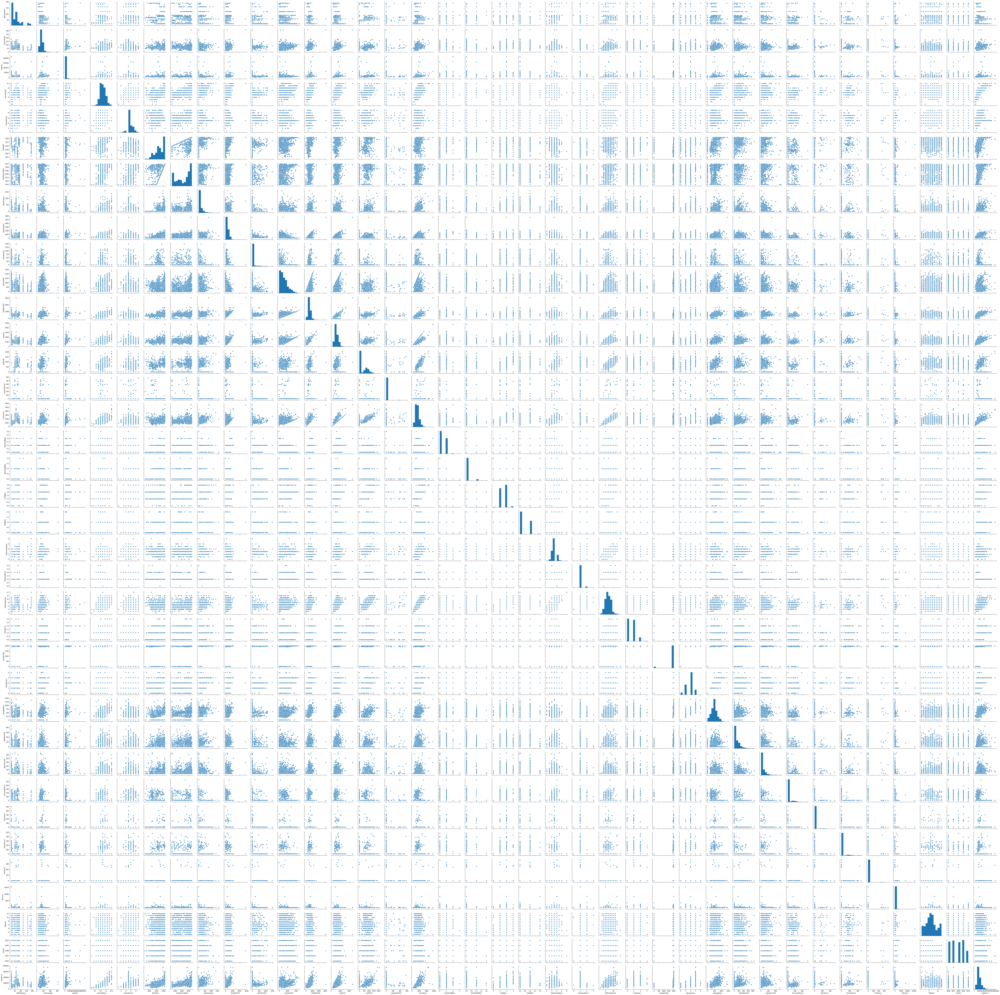

In [21]:
# paiwise scatter plot

plt.figure(figsize=(20, 10))
sns.pairplot(Housing)
plt.show()

In [258]:
# all numeric (float and int) variables in the dataset
Housing_numeric = Housing.select_dtypes(include=['float64', 'int64'])
Housing_numeric.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,60,65.0,8450,7,5,2003,2003,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0,2,2008,208500
1,20,80.0,9600,6,8,1976,1976,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0,5,2007,181500
2,60,68.0,11250,7,5,2001,2002,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0,9,2008,223500
3,70,60.0,9550,7,5,1915,1970,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0,2,2006,140000
4,60,84.0,14260,8,5,2000,2000,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0,12,2008,250000


In [73]:
Housing_numeric.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 37 columns):
MSSubClass       1460 non-null int64
LotFrontage      1460 non-null float64
LotArea          1460 non-null int64
OverallQual      1460 non-null int64
OverallCond      1460 non-null int64
YearBuilt        1460 non-null int64
YearRemodAdd     1460 non-null int64
MasVnrArea       1460 non-null float64
BsmtFinSF1       1460 non-null int64
BsmtFinSF2       1460 non-null int64
BsmtUnfSF        1460 non-null int64
TotalBsmtSF      1460 non-null int64
1stFlrSF         1460 non-null int64
2ndFlrSF         1460 non-null int64
LowQualFinSF     1460 non-null int64
GrLivArea        1460 non-null int64
BsmtFullBath     1460 non-null int64
BsmtHalfBath     1460 non-null int64
FullBath         1460 non-null int64
HalfBath         1460 non-null int64
BedroomAbvGr     1460 non-null int64
KitchenAbvGr     1460 non-null int64
TotRmsAbvGrd     1460 non-null int64
Fireplaces       1460 non-null int64
G

In [23]:
# correlation matrix
cor = Housing_numeric.corr()
cor

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
MSSubClass,1.000000,-0.370367,-0.139781,0.032628,-0.059316,0.027850,0.040581,0.023573,-0.069836,-0.065649,...,-0.012579,-0.006100,-0.012037,-0.043825,-0.026030,0.008283,-0.007683,-0.013585,-0.021407,-0.084284
LotFrontage,-0.370367,1.000000,0.335957,0.239546,-0.043595,0.120999,0.084550,0.195830,0.232576,0.052237,...,0.088736,0.141734,0.008057,0.064654,0.041063,0.174567,0.005332,0.007370,0.004756,0.349876
LotArea,-0.139781,0.335957,1.000000,0.105806,-0.005636,0.014228,0.013788,0.103321,0.214103,0.111170,...,0.171698,0.084774,-0.018340,0.020423,0.043160,0.077672,0.038068,0.001205,-0.014261,0.263843
OverallQual,0.032628,0.239546,0.105806,1.000000,-0.091932,0.572323,0.550684,0.407252,0.239666,-0.059119,...,0.238923,0.308819,-0.113937,0.030371,0.064886,0.065166,-0.031406,0.070815,-0.027347,0.790982
OverallCond,-0.059316,-0.043595,-0.005636,-0.091932,1.000000,-0.375983,0.073741,-0.125694,-0.046231,0.040229,...,-0.003334,-0.032589,0.070356,0.025504,0.054811,-0.001985,0.068777,-0.003511,0.043950,-0.077856
YearBuilt,0.027850,0.120999,0.014228,0.572323,-0.375983,1.000000,0.592855,0.311600,0.249503,-0.049107,...,0.224880,0.188686,-0.387268,0.031355,-0.050364,0.004950,-0.034383,0.012398,-0.013618,0.522897
YearRemodAdd,0.040581,0.084550,0.013788,0.550684,0.073741,0.592855,1.000000,0.176529,0.128451,-0.067759,...,0.205726,0.226298,-0.193919,0.045286,-0.038740,0.005829,-0.010286,0.021490,0.035743,0.507101
MasVnrArea,0.023573,0.195830,0.103321,0.407252,-0.125694,0.311600,0.176529,1.000000,0.261256,-0.071330,...,0.159991,0.122528,-0.109907,0.019144,0.062248,0.011928,-0.029512,-0.006723,-0.008317,0.472614
BsmtFinSF1,-0.069836,0.232576,0.214103,0.239666,-0.046231,0.249503,0.128451,0.261256,1.000000,-0.050117,...,0.204306,0.111761,-0.102303,0.026451,0.062021,0.140491,0.003571,-0.015727,0.014359,0.386420
BsmtFinSF2,-0.065649,0.052237,0.111170,-0.059119,0.040229,-0.049107,-0.067759,-0.071330,-0.050117,1.000000,...,0.067898,0.003093,0.036543,-0.029993,0.088871,0.041709,0.004940,-0.015211,0.031706,-0.011378


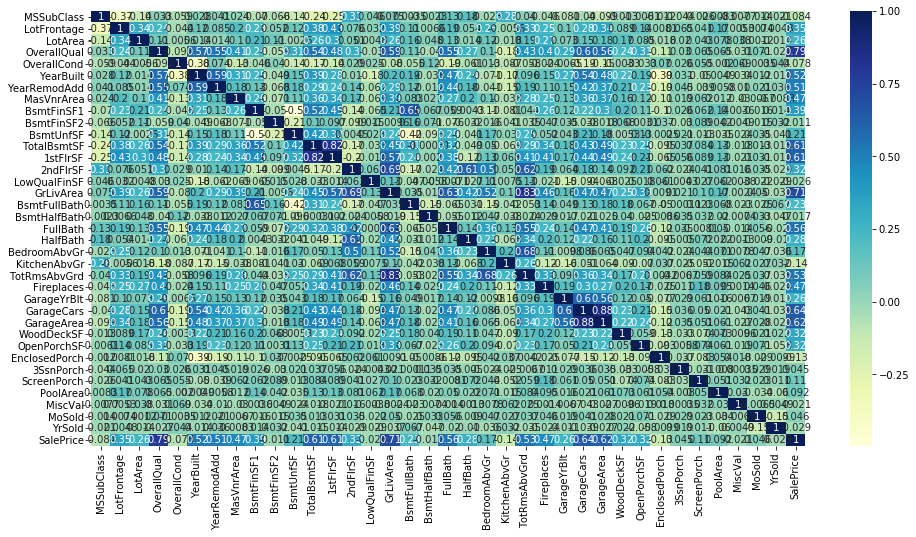

In [24]:
# plotting correlations on a heatmap

# figure size
plt.figure(figsize=(16,8))

# heatmap
sns.heatmap(cor, cmap="YlGnBu", annot=True)
plt.show()


In [25]:
#Plots for the variable "GrLivArea" with the target variable "Sale Price"

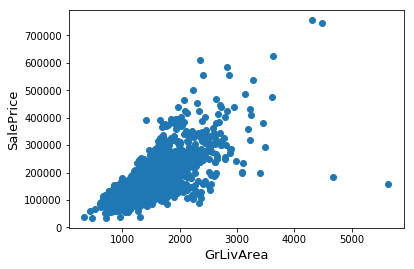

In [26]:
fig, ax = plt.subplots()
ax.scatter(x = Housing['GrLivArea'], y = Housing['SalePrice'])
plt.ylabel('SalePrice', fontsize=13)
plt.xlabel('GrLivArea', fontsize=13)
plt.show()

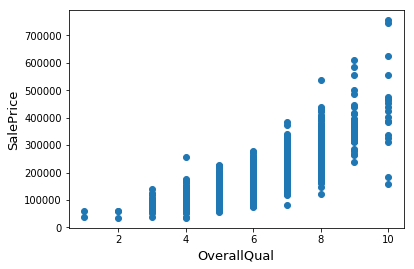

In [30]:
fig, ax = plt.subplots()
ax.scatter(x = Housing['OverallQual'], y = Housing['SalePrice'])
plt.ylabel('SalePrice', fontsize=13)
plt.xlabel('OverallQual', fontsize=13)
plt.show()

In [27]:
#Finding out the most correlated features

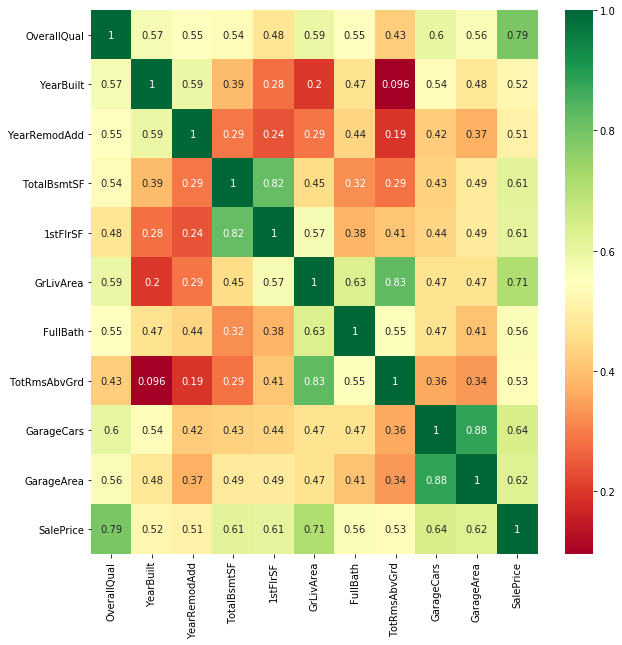

In [29]:

top_corr_features = cor.index[abs(cor["SalePrice"])>0.5]
plt.figure(figsize=(10,10))
g = sns.heatmap(Housing[top_corr_features].corr(),annot=True,cmap="RdYlGn")

In [31]:
#Most features such as Garage Cars and Garage Area are correlated with eavh other

In [32]:
##OverallQual is highly correlated with target feature SalePrice 0.79 

In [34]:
#Plotting bar plot for the variable overallqual

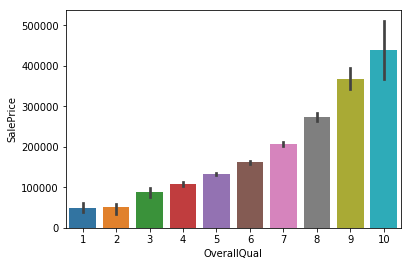

In [33]:
sns.barplot(Housing.OverallQual,Housing.SalePrice)


In [35]:
Housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 80 columns):
MSSubClass       1460 non-null int64
MSZoning         1460 non-null object
LotFrontage      1460 non-null float64
LotArea          1460 non-null int64
Street           1460 non-null object
Alley            1460 non-null object
LotShape         1460 non-null object
LandContour      1460 non-null object
Utilities        1460 non-null object
LotConfig        1460 non-null object
LandSlope        1460 non-null object
Neighborhood     1460 non-null object
Condition1       1460 non-null object
Condition2       1460 non-null object
BldgType         1460 non-null object
HouseStyle       1460 non-null object
OverallQual      1460 non-null int64
OverallCond      1460 non-null int64
YearBuilt        1460 non-null int64
YearRemodAdd     1460 non-null int64
RoofStyle        1460 non-null object
RoofMatl         1460 non-null object
Exterior1st      1460 non-null object
Exterior2nd      1460 no

In [259]:
# Dropping the outlier 
Housing = Housing.drop(Housing[(Housing['GrLivArea']>4000) & (Housing['SalePrice']<300000)].index)

In [50]:
#Changing few features to categorical feature

In [260]:
Housing['OverallCond'] = Housing['OverallCond'].astype('object')


In [261]:
Housing['MSSubClass'] = Housing['MSSubClass'].astype('object')

In [262]:
#Year and month sold are transformed into categorical features.
Housing['YrSold'] = Housing['YrSold'].astype('object')
Housing['MoSold'] = Housing['MoSold'].astype('object')

In [55]:
Housing.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1458 entries, 0 to 1459
Data columns (total 79 columns):
MSSubClass       1458 non-null object
MSZoning         1458 non-null object
LotFrontage      1458 non-null float64
LotArea          1458 non-null int64
Street           1458 non-null object
Alley            1458 non-null object
LotShape         1458 non-null object
LandContour      1458 non-null object
LotConfig        1458 non-null object
LandSlope        1458 non-null object
Neighborhood     1458 non-null object
Condition1       1458 non-null object
Condition2       1458 non-null object
BldgType         1458 non-null object
HouseStyle       1458 non-null object
OverallQual      1458 non-null int64
OverallCond      1458 non-null object
YearBuilt        1458 non-null int64
YearRemodAdd     1458 non-null int64
RoofStyle        1458 non-null object
RoofMatl         1458 non-null object
Exterior1st      1458 non-null object
Exterior2nd      1458 non-null object
MasVnrType       1458 

In [56]:
#Data Preparation

In [57]:
#Data Preparation
#Let's now prepare the data and build the model.

In [58]:
#Taking out the target variables

In [263]:
y = Housing.loc[:,['SalePrice']]

In [264]:
X = Housing.loc[:,['MSZoning','Street','Alley','LotShape','LandContour','Utilities',
       'LotConfig','LandSlope','Neighborhood','Condition1','Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature',
       'SaleType', 'SaleCondition','MSSubClass','LotFrontage','LotArea','OverallQual','OverallCond','YearBuilt','YearRemodAdd',   
'MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath',     
'BsmtHalfBath','FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars',       
'GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal','MoSold','YrSold']]

In [77]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1458 entries, 0 to 1459
Data columns (total 79 columns):
MSZoning         1458 non-null object
Street           1458 non-null object
Alley            1458 non-null object
LotShape         1458 non-null object
LandContour      1458 non-null object
Utilities        0 non-null float64
LotConfig        1458 non-null object
LandSlope        1458 non-null object
Neighborhood     1458 non-null object
Condition1       1458 non-null object
Condition2       1458 non-null object
BldgType         1458 non-null object
HouseStyle       1458 non-null object
RoofStyle        1458 non-null object
RoofMatl         1458 non-null object
Exterior1st      1458 non-null object
Exterior2nd      1458 non-null object
MasVnrType       1458 non-null object
ExterQual        1458 non-null object
ExterCond        1458 non-null object
Foundation       1458 non-null object
BsmtQual         1458 non-null object
BsmtCond         1458 non-null object
BsmtExposure     1458

In [265]:
# creating dummy variables for categorical variables

# subset all categorical variables
Housing_categorical = X.select_dtypes(include=['object'])
Housing_categorical.head()

,MSZoning,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition,MSSubClass,OverallCond,MasVnrArea,MoSold,YrSold
0,RL,Pave,None,Reg,Lvl,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,None,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal,60,5,196,2,2008
1,RL,Pave,None,Reg,Lvl,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,Gable,CompShg,MetalSd,MetalSd,None,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal,20,8,0,5,2007
2,RL,Pave,None,IR1,Lvl,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal,60,5,162,9,2008
3,RL,Pave,None,IR1,Lvl,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,Gable,CompShg,Wd Sdng,Wd Shng,None,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Gd,Detchd,Unf,TA,TA,Y,None,None,None,WD,Abnorml,70,5,0,2,2006
4,RL,Pave,None,IR1,Lvl,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,None,None,None,WD,Normal,60,5,350,12,2008


In [266]:
# convert into dummies
Housing_dummies = pd.get_dummies(Housing_categorical, drop_first=True)
Housing_dummies.head()

,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_None,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_Fa,PoolQC_Gd,PoolQC_None,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial,MSSubClass_30,MSSubClass_40,MSSubClass_45,MSSubClass_50,MSSubClass_60,MSSubClass_70,MSSubClass_75,MSSubClass_80,MSSubClass_85,MSSubClass_90,MSSubClass_120,MSSubClass_160,MSSubClass_180,MSSubClass_190,OverallCond_2,OverallCond_3,OverallCond_4,OverallCond_5,OverallCond_6,OverallCond_7,OverallCond_8,OverallCond_9,MasVnrArea_1.0,MasVnrArea_11.0,MasVnrArea_14.0,MasVnr

In [267]:
# drop categorical variables 
X = X.drop(list(Housing_categorical.columns), axis=1)

In [268]:
# concat dummy variables with X
X = pd.concat([X, Housing_dummies], axis=1)

In [269]:
# scaling the features
from sklearn.preprocessing import scale

# scaling (the df is converted to a numpy array)
cols = X.columns
X = pd.DataFrame(scale(X))
X.columns = cols
X.columns

Index(['Utilities', 'LotFrontage', 'LotArea', 'OverallQual', 'YearBuilt',
       'YearRemodAdd', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF',
       ...
       'MoSold_7', 'MoSold_8', 'MoSold_9', 'MoSold_10', 'MoSold_11',
       'MoSold_12', 'YrSold_2007', 'YrSold_2008', 'YrSold_2009',
       'YrSold_2010'],
      dtype='object', length=615)

In [270]:
# split into train and test
from sklearn.model_selection import train_test_split


In [271]:
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    train_size=0.7,
                                                    test_size = 0.3, random_state=100)

In [272]:
X_train.fillna(X_test.mean())


,Utilities,LotFrontage,LotArea,OverallQual,YearBuilt,YearRemodAdd,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_None,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_Fa,PoolQC_Gd,PoolQC_None,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,...,MasVnrArea_146.0,MasVnrArea_147.0,MasVnrArea_148.0,MasVnrArea_149.0,Mas

In [96]:
X.head(10)

,LotFrontage,LotArea,OverallQual,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,...,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010
0,-0.232605,-0.203934,0.658506,1.052959,0.880362,0.523937,0.617283,-0.288867,-0.943795,-0.473766,...,-0.437237,-0.302188,-0.212512,-0.253443,-0.239349,-0.205361,-0.538763,1.952404,-0.549350,-0.369322
1,0.466313,-0.087252,-0.068293,0.158428,-0.428115,-0.570739,1.245719,-0.288867,-0.640584,0.504925,...,-0.437237,-0.302188,-0.212512,-0.253443,-0.239349,-0.205361,1.856104,-0.512189,-0.549350,-0.369322
2,-0.092822,0.080162,0.658506,0.986698,0.831900,0.334044,0.108989,-0.288867,-0.301168,-0.319490,...,-0.437237,-0.302188,4.705620,-0.253443,-0.239349,-0.205361,-0.538763,1.952404,-0.549350,-0.369322
3,-0.465578,-0.092325,0.658506,-1.862551,-0.718888,-0.570739,-0.514826,-0.288867,-0.061314,-0.714823,...,-0.437237,-0.302188,-0.212512,-0.253443,-0.239349,-0.205361,-0.538763,-0.512189,-0.549350,-0.369322
4,0.652691,0.385566,1.385305,0.953567,0.734975,1.384039,0.499451,-0.288867,-0.174452,0.222888,...,-0.437237,-0.302188,-0.212512,-0.253443,-0.239349,4.869483,-0.538763,1.952404,-0.549350,-0.369322
5,0.699286,0.370853,-0.795092,0.721651,0.492665,-0.570739,0.677354,-0.288867,-1.138394,-0.618400,...,-0.437237,-0.302188,-0.212512,3.945654,-0.239349,-0.205361,-0.538763,-0.512189,1.820332,-0.369322
6,0.233340,-0.038144,1.385305,1.086090,0.977286,0.468086,2.149096,-0.288867,-0.565912,1.527006,...,-0.437237,3.309202,-0.212512,-0.253443,-0.239349,-0.205361,1.856104,-0.512189,-0.549350,-0.369322
7,0.466313,-0.007908,0.658506,0.059036,-0.573501,0.769680,0.970778,-0.090560,-0.794452,0.131287,...,-0.437237,-0.302188,-0.212512,-0.253443,4.178001,-0.205361,-0.538763,-0.512189,1.820332,-0.369322
8,-0.884929,-0.440343,0.658506,-1.332458,-1.688130,-0.570739,-1.013878,-0.288867,0.870949,-0.242351,...,-0.437237,-0.302188,-0.212512,-0.253443,-0.239349,-0.205361,-0.538763,1.952404,-0.549350,-0.369322
9,-0.931524,-0.308441,-0.795092,-1.067412,-1.688130,-0.570739,0.952295,-0.288867,-0.966423,-0.148339,...,-0.437237,-0.302188,-0.212512,-0.253443,-0.239349,-0.205361,-0.538763,1.952404,-0.549350,-0.369322


In [273]:
X = X.drop("Utilities", axis=1)


In [98]:
#Model Biulding and prediction

In [99]:
#Ridge Regression

In [97]:
# list of alphas to tune
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}


ridge = Ridge()

# cross validation
folds = 5
model_cv = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
model_cv.fit(X_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    4.6s finished


GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring='neg_mean_absolute_error', verbose=1)

In [100]:
cv_results = pd.DataFrame(model_cv.cv_results_)
cv_results = cv_results[cv_results['param_alpha']<=200]
cv_results.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.492854,0.965260,0.043084,0.083180,0.0001,{'alpha': 0.0001},-0.098189,-0.084817,-0.098462,-0.092123,...,-0.094534,0.005472,28,-0.052557,-0.054867,-0.052651,-0.057404,-0.054276,-0.054351,0.001772
1,0.009978,0.000007,0.001392,0.000482,0.001,{'alpha': 0.001},-0.098189,-0.084781,-0.098458,-0.092066,...,-0.094515,0.005489,27,-0.052556,-0.054866,-0.052652,-0.057406,-0.054276,-0.054351,0.001773
2,0.009779,0.000748,0.001392,0.000491,0.01,{'alpha': 0.01},-0.098186,-0.084450,-0.098420,-0.091534,...,-0.094330,0.005646,26,-0.052553,-0.054858,-0.052664,-0.057423,-0.054280,-0.054355,0.001776
3,0.010573,0.000488,0.001794,0.000398,0.05,{'alpha': 0.05},-0.098163,-0.083402,-0.098318,-0.089748,...,-0.093723,0.006178,24,-0.052545,-0.054853,-0.052707,-0.057481,-0.054292,-0.054375,0.001790
4,0.009978,0.000624,0.001392,0.000482,0.1,{'alpha': 0.1},-0.098110,-0.082712,-0.098235,-0.088261,...,-0.093243,0.006578,23,-0.052540,-0.054852,-0.052745,-0.057538,-0.054302,-0.054395,0.001803


In [107]:
# plotting mean test and train scoes with alpha 
cv_results['param_alpha'] = cv_results['param_alpha'].astype('int32')


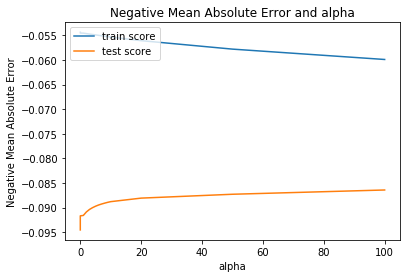

In [108]:
# plotting
plt.plot(cv_results['param_alpha'], cv_results['mean_train_score'])
plt.plot(cv_results['param_alpha'], cv_results['mean_test_score'])
plt.xlabel('alpha')
plt.ylabel('Negative Mean Absolute Error')
plt.title("Negative Mean Absolute Error and alpha")
plt.legend(['train score', 'test score'], loc='upper left')
plt.show()

In [109]:
alpha = 15
ridge = Ridge(alpha=alpha)

ridge.fit(X_train, y_train)
ridge.coef_

array([[ 4.71879552e-03,  3.82206140e-02,  4.74604473e-02,
         6.13846354e-02,  2.09808410e-02,  3.00237325e-03,
         2.86564824e-02,  1.15431634e-02,  1.03530582e-02,
         4.54179143e-02,  3.52669799e-02,  5.15875119e-02,
        -9.42206367e-04,  6.99720541e-02,  8.08596943e-03,
         6.18677961e-04,  1.39904593e-02,  1.59118088e-02,
        -3.88965431e-03, -1.81796552e-02, -2.10384972e-03,
         1.27625555e-02,  6.36146241e-05,  1.35104726e-02,
         1.72015164e-02,  1.08700779e-02,  3.73986180e-03,
         2.24347446e-03,  2.87654897e-03,  1.06292366e-02,
         3.72827299e-03,  1.55089395e-03,  3.88022730e-02,
         1.39114684e-02,  6.22080015e-02,  4.95763012e-02,
         7.23052269e-03, -5.37351490e-03,  3.87068584e-03,
        -3.49644820e-04,  4.74363453e-04,  5.93407667e-03,
         5.83066541e-03, -4.06648568e-04,  6.28694489e-03,
         7.80213755e-03, -5.86866718e-03, -5.54798648e-03,
        -6.79162858e-03,  4.79684551e-03, -3.40982626e-0

In [133]:
#Doubling the alpha value and biulding the model

In [134]:
alpha = 30
ridge = Ridge(alpha=alpha)

ridge.fit(X_train, y_train)
ridge.coef_

array([[ 5.40324820e-03,  3.50464335e-02,  4.84595372e-02,
         5.21310669e-02,  2.09671457e-02,  4.18366915e-03,
         2.77755122e-02,  1.08501367e-02,  9.58578900e-03,
         4.34118009e-02,  3.68860397e-02,  4.48232632e-02,
        -1.94030019e-03,  6.52632021e-02,  8.35664465e-03,
         2.23614319e-06,  1.50518322e-02,  1.67733872e-02,
        -3.42688319e-03, -1.73632894e-02,  8.61252679e-04,
         1.28144502e-02,  1.73366945e-03,  1.39315293e-02,
         1.75923247e-02,  1.10664632e-02,  4.48461084e-03,
         1.76506401e-03,  3.12471060e-03,  1.00560846e-02,
         3.50892424e-03,  1.53040627e-03,  2.73161074e-02,
         8.70114073e-03,  4.15700439e-02,  3.13039725e-02,
         6.93151715e-03, -4.64531649e-03,  4.15587084e-03,
        -3.29857703e-04,  7.91661390e-04,  5.07203370e-03,
         5.14787699e-03, -1.42104182e-03,  5.28749762e-03,
         7.95359678e-03, -5.91247173e-03, -5.13716051e-03,
        -6.29776034e-03,  4.80940539e-03, -3.01909788e-0

In [110]:
#Lasso

In [275]:
X_train.head()

,Utilities,LotFrontage,LotArea,OverallQual,YearBuilt,YearRemodAdd,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_None,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_Fa,PoolQC_Gd,PoolQC_None,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,...,MasVnrArea_146.0,MasVnrArea_147.0,MasVnrArea_148.0,MasVnrArea_149.0,Mas

In [276]:
X_train = X_train.drop("Utilities", axis=1)


In [277]:
lasso = Lasso()

# cross validation
model_cv = GridSearchCV(estimator = lasso, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            

model_cv.fit(X_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:  1.4min finished


GridSearchCV(cv=KFold(n_splits=5, random_state=4, shuffle=True),
       error_score='raise-deprecating',
       estimator=Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring='neg_mean_absolute_error', verbose=1)

In [135]:
lasso = Lasso()

# cross validation
model_cv = GridSearchCV(estimator = lasso, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            

model_cv.fit(X_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    5.4s finished


GridSearchCV(cv=KFold(n_splits=5, random_state=4, shuffle=True),
       error_score='raise-deprecating',
       estimator=Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring='neg_mean_absolute_error', verbose=1)

In [278]:
cv_results = pd.DataFrame(model_cv.cv_results_)
cv_results.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.831935,0.421965,0.003325,0.006159,0.0001,{'alpha': 0.0001},-20382.191812,-23811.522880,-25464.839016,-25457.566576,-22318.010901,-23486.826237,1944.564946,28,-7397.154423,-7322.770651,-6530.017635,-6987.854775,-7778.290484,-7203.217594,420.045851
1,0.573859,0.035032,0.003124,0.006248,0.001,{'alpha': 0.001},-20382.085227,-23811.369330,-25462.701472,-25457.061510,-22317.839998,-23486.211507,1944.077255,27,-7397.152317,-7322.768120,-6530.021742,-6987.859688,-7778.291010,-7203.218576,420.043836
2,0.607734,0.045441,0.006500,0.007563,0.01,{'alpha': 0.01},-20381.019494,-23809.353504,-25441.334399,-25452.026919,-22316.049786,-23479.956820,1939.208952,26,-7397.144612,-7322.760533,-6530.079044,-6987.910636,-7778.312441,-7203.241453,420.024970
3,0.628247,0.037744,0.006258,0.007665,0.05,{'alpha': 0.05},-20377.119328,-23799.064159,-25348.188155,-25429.885011,-22306.747060,-23452.200743,1918.046267,25,-7397.253252,-7322.849966,-6530.437322,-6988.177052,-7778.507552,-7203.445029,419.951366
4,0.669211,0.030126,0.000000,0.000000,0.1,{'alpha': 0.1},-20372.176096,-23788.413759,-25235.211748,-25402.383291,-22295.195620,-23418.676103,1892.879953,24,-7397.423559,-7323.061282,-6530.914884,-6988.573608,-7778.797130,-7203.754092,419.864694


In [136]:
cv_results = pd.DataFrame(model_cv.cv_results_)
cv_results.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.276758,0.018252,0.012136,0.008649,0.0001,{'alpha': 0.0001},-0.090885,-0.082257,-0.094325,-0.087987,...,-0.088476,0.004033,3,-0.055043,-0.055965,-0.055667,-0.055239,-0.053953,-0.055173,0.000690
1,0.161074,0.129087,0.004404,0.005816,0.001,{'alpha': 0.001},-0.084799,-0.076906,-0.082195,-0.079601,...,-0.081543,0.002947,1,-0.058273,-0.058985,-0.058937,-0.058318,-0.058065,-0.058515,0.000374
2,0.032224,0.015059,0.003321,0.006162,0.01,{'alpha': 0.01},-0.092100,-0.083059,-0.086636,-0.083112,...,-0.086676,0.003419,2,-0.079116,-0.080589,-0.080522,-0.080298,-0.079157,-0.079936,0.000660
3,0.019831,0.005777,0.000911,0.001823,0.05,{'alpha': 0.05},-0.118784,-0.108959,-0.120730,-0.103030,...,-0.113359,0.006535,4,-0.110324,-0.112303,-0.112387,-0.112967,-0.109678,-0.111532,0.001287
4,0.016456,0.000830,0.000412,0.000824,0.1,{'alpha': 0.1},-0.149481,-0.145487,-0.163853,-0.137712,...,-0.150299,0.008806,5,-0.146188,-0.147959,-0.152470,-0.149116,-0.148663,-0.148879,0.002053


In [283]:
alpha =600

lasso = Lasso(alpha=alpha)
        
lasso.fit(X_train, y_train) 

Lasso(alpha=600, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False)

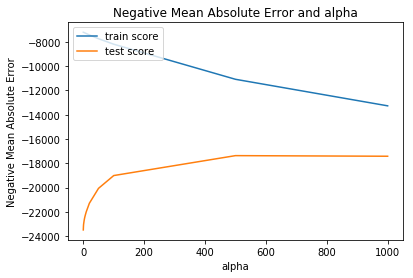

In [280]:
# plotting mean test and train scoes with alpha 
cv_results['param_alpha'] = cv_results['param_alpha'].astype('float32')

# plotting
plt.plot(cv_results['param_alpha'], cv_results['mean_train_score'])
plt.plot(cv_results['param_alpha'], cv_results['mean_test_score'])
plt.xlabel('alpha')
plt.ylabel('Negative Mean Absolute Error')

plt.title("Negative Mean Absolute Error and alpha")
plt.legend(['train score', 'test score'], loc='upper left')
plt.show()

In [284]:
lasso.coef_

array([ 3.20843734e+02,  5.53054774e+03,  1.20419411e+04,  8.29142796e+03,
        3.30500518e+03,  6.41531074e+03,  0.00000000e+00, -0.00000000e+00,
        1.07511339e+04,  0.00000000e+00,  0.00000000e+00, -2.32135496e+03,
        2.94740175e+04,  0.00000000e+00, -4.69439850e+02,  0.00000000e+00,
        0.00000000e+00, -2.69723597e+03, -5.06325509e+03,  0.00000000e+00,
        1.27948639e+03, -0.00000000e+00,  3.72195535e+03,  6.70809131e+02,
        8.43250282e+02,  6.57691677e+02, -4.62803938e+02,  0.00000000e+00,
        1.86392961e+02,  3.35173475e+03,  0.00000000e+00,  9.45383078e+01,
       -0.00000000e+00,  0.00000000e+00, -9.22760511e+02,  5.95780016e+02,
        0.00000000e+00, -0.00000000e+00,  9.57622052e+01, -0.00000000e+00,
        0.00000000e+00,  7.25214564e+02, -0.00000000e+00, -0.00000000e+00,
        1.22677528e+03, -1.25146792e+02, -3.03059622e+02,  0.00000000e+00,
        1.37784905e+02, -2.57500356e+03,  0.00000000e+00, -0.00000000e+00,
        9.08656567e+02,  

In [305]:
#Trying different values of alpha

In [289]:
# lasso regression
lm = Lasso(alpha=0.001)
lm.fit(X_train, y_train)

# predict
y_train_pred = lm.predict(X_train)
print(metrics.r2_score(y_true=y_train, y_pred=y_train_pred))

0.976145709820104


In [294]:
# lasso model parameters
model_parameters = list(lm.coef_)


In [295]:
model_parameters.insert(0, lm.intercept_)


In [300]:
cols = X.columns


In [301]:
cols = cols.insert(0, "constant")


In [303]:
#Finding the features used by lasso

In [302]:
list(zip(cols, model_parameters))

[('constant', array([180084.82788962])),
 ('LotFrontage', -100.76015170645766),
 ('LotArea', 7494.43399855977),
 ('OverallQual', 6961.407004364695),
 ('YearBuilt', 10891.275950174844),
 ('YearRemodAdd', 2210.858530398313),
 ('BsmtFinSF1', 14612.483905375728),
 ('BsmtFinSF2', 5500.677527594886),
 ('BsmtUnfSF', 7246.363489121805),
 ('TotalBsmtSF', 4539.252205538909),
 ('1stFlrSF', 15672.42221835803),
 ('2ndFlrSF', 21392.379305348164),
 ('LowQualFinSF', -1542.3064306993215),
 ('GrLivArea', 4215.414271788474),
 ('BsmtFullBath', -567.0972932501),
 ('BsmtHalfBath', -1069.7976463274601),
 ('FullBath', 2454.1676630518878),
 ('HalfBath', 903.926045755554),
 ('BedroomAbvGr', -2216.5587809889093),
 ('KitchenAbvGr', -6075.6717665783235),
 ('TotRmsAbvGrd', -723.7367756990626),
 ('Fireplaces', 4492.229419099784),
 ('GarageYrBlt', 8824.922012926922),
 ('GarageCars', 5125.711055359648),
 ('GarageArea', 175.67739662197576),
 ('WoodDeckSF', 1228.280147478219),
 ('OpenPorchSF', 1287.3253667577592),
 ('En

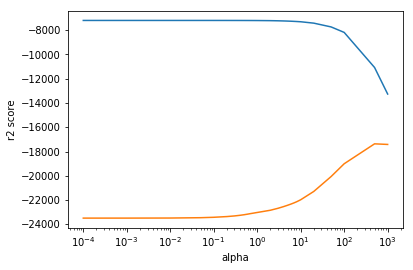

In [304]:
# plot
cv_results['param_alpha'] = cv_results['param_alpha'].astype('float32')
plt.plot(cv_results['param_alpha'], cv_results['mean_train_score'])
plt.plot(cv_results['param_alpha'], cv_results['mean_test_score'])
plt.xlabel('alpha')
plt.ylabel('r2 score')
plt.xscale('log')
plt.show()

In [306]:
# lasso regression
lm = Lasso(alpha=300)
lm.fit(X_train, y_train)

# predict
y_train_pred = lm.predict(X_train)
print(metrics.r2_score(y_true=y_train, y_pred=y_train_pred))

0.9658498262338764


In [307]:
# lasso model parameters
model_parameters = list(lm.coef_)
model_parameters.insert(0, lm.intercept_)
cols = X.columns
cols = cols.insert(0, "constant")
list(zip(cols, model_parameters))

[('constant', array([180493.17172202])),
 ('LotFrontage', 0.0),
 ('LotArea', 6579.670367266532),
 ('OverallQual', 9755.126237521872),
 ('YearBuilt', 9377.996335180207),
 ('YearRemodAdd', 2705.7679465251367),
 ('BsmtFinSF1', 6160.10140790232),
 ('BsmtFinSF2', 855.1693280148455),
 ('BsmtUnfSF', -0.0),
 ('TotalBsmtSF', 10747.669584343263),
 ('1stFlrSF', 0.0),
 ('2ndFlrSF', 412.51863021924254),
 ('LowQualFinSF', -2743.8270019387833),
 ('GrLivArea', 29095.54735872152),
 ('BsmtFullBath', 0.0),
 ('BsmtHalfBath', -932.028018366636),
 ('FullBath', 207.88000472463727),
 ('HalfBath', 256.6433532218754),
 ('BedroomAbvGr', -2547.5296692639035),
 ('KitchenAbvGr', -5440.816840256315),
 ('TotRmsAbvGrd', 0.0),
 ('Fireplaces', 1280.3951282441178),
 ('GarageYrBlt', -0.0),
 ('GarageCars', 4570.92288157244),
 ('GarageArea', 0.0),
 ('WoodDeckSF', 1030.4783706188907),
 ('OpenPorchSF', 875.8570452583429),
 ('EnclosedPorch', -1032.0767016706918),
 ('3SsnPorch', 0.0),
 ('ScreenPorch', 326.22543037046245),
 ('Po

In [308]:
# grid search CV

# set up cross validation scheme
folds = KFold(n_splits = 5, shuffle = True, random_state = 4)

# specify range of hyperparameters
params = {'alpha': [0.001, 0.01, 1.0, 5.0, 10.0]}

# grid search
# lasso model
model = Lasso()
model_cv = GridSearchCV(estimator = model, param_grid = params, 
                        scoring= 'r2', 
                        cv = folds, 
                        return_train_score=True, verbose = 1)            
model_cv.fit(X_train, y_train) 

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  25 out of  25 | elapsed:    9.5s finished


GridSearchCV(cv=KFold(n_splits=5, random_state=4, shuffle=True),
       error_score='raise-deprecating',
       estimator=Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'alpha': [0.001, 0.01, 1.0, 5.0, 10.0]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring='r2', verbose=1)

In [309]:
cv_results = pd.DataFrame(model_cv.cv_results_)
cv_results.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.440331,0.084196,0.006241,0.007644,0.001,{'alpha': 0.001},0.853167,0.683659,0.806006,0.760553,0.844415,0.789560,0.062261,5,0.981519,0.980736,0.984546,0.983824,0.978551,0.981835,0.002163
1,0.346794,0.020723,0.000000,0.000000,0.01,{'alpha': 0.01},0.853179,0.683691,0.806171,0.760637,0.844445,0.789625,0.062258,4,0.981519,0.980736,0.984546,0.983824,0.978551,0.981835,0.002163
2,0.334297,0.039021,0.003124,0.006248,1,{'alpha': 1.0},0.854473,0.686861,0.815019,0.769395,0.845919,0.794333,0.061446,3,0.981500,0.980722,0.984539,0.983792,0.978531,0.981817,0.002164
3,0.349918,0.023380,0.003124,0.006248,5,{'alpha': 5.0},0.858553,0.697954,0.820545,0.786408,0.850982,0.802888,0.058320,2,0.981392,0.980623,0.984471,0.983637,0.978407,0.981706,0.002169
4,0.399588,0.069579,0.001397,0.001954,10,{'alpha': 10.0},0.862358,0.708540,0.822332,0.798032,0.856698,0.809592,0.055697,1,0.981249,0.980470,0.984376,0.983423,0.978208,0.981545,0.002187


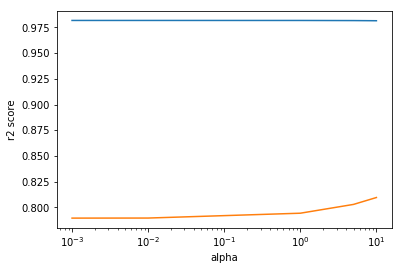

In [310]:
# plot
cv_results['param_alpha'] = cv_results['param_alpha'].astype('float32')
plt.plot(cv_results['param_alpha'], cv_results['mean_train_score'])
plt.plot(cv_results['param_alpha'], cv_results['mean_test_score'])
plt.xlabel('alpha')
plt.ylabel('r2 score')
plt.xscale('log')
plt.show()